In [1]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

In [2]:
import dataloader as dal

In [3]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

# https://zhuanlan.zhihu.com/p/480348215
# 一些默认配置，使得图表更美观
large = 22; med = 16; small = 12
params = {'axes.titlesize': large,
          'legend.fontsize': med,
          'figure.figsize': (16, 10),
          'axes.labelsize': med,
          'axes.titlesize': med,
          'xtick.labelsize': med,
          'ytick.labelsize': med,
          'figure.titlesize': large}
plt.rcParams.update(params)
plt.style.use('seaborn-dark')
#sns.set_style("white")
# 设置matplotlib正常显示中文
plt.rcParams['font.sans-serif']=['SimHei']   # 用黑体显示中文
plt.rcParams['axes.unicode_minus']=False 

In [4]:
dl = dal.dataloader()
_=dl.get_slist()
dl.filter_slist(pd.to_datetime('2014-01-01'))
dl.get_sdata_tdx('E:/s/tdx/',start="2018/01/01",end='2021/01/31')

100%|██████████| 197/197 [00:04<00:00, 49.09it/s]


,,open,high,low,close,volume,amount
date,code,,,,,,
2018-01-02,000001,12.44,13.02,12.41,12.79,208159200.0,2.856543e+09
2018-01-03,000001,12.82,12.95,12.29,12.42,296249792.0,4.006220e+09
2018-01-04,000001,12.41,12.46,12.22,12.34,185450896.0,2.454543e+09
2018-01-05,000001,12.30,12.44,12.24,12.39,121031200.0,1.603289e+09
2018-01-08,000001,12.34,12.38,11.95,12.05,215862000.0,2.806099e+09
...,...,...,...,...,...,...,...
2021-01-25,300274,98.75,113.37,97.56,102.25,81047212.0,8.559588e+09
2021-01-26,300274,98.75,100.03,94.12,95.33,86710593.0,8.400924e+09
2021-01-27,300274,97.64,104.25,92.26,104.25,72114934.0,7.084138e+09


In [5]:
dl.sdata['factor']=dal.alpha_6(dl.sdata)
dl.sdata['factor']=dal.shift_ndate(dl.sdata.factor,1)

In [6]:
def return_nd(x,n):
    return x.groupby(by='code').apply(lambda x: x-x.shift(n))

In [7]:
def momentum_nd(data,n):
    return return_nd(data.close,n)

In [8]:
dl.sdata['factor1']=dal.momentum_nd(dl.sdata,3)
dl.sdata['factor1']=dal.shift_ndate(dl.sdata.factor1,1)

In [9]:
temp=dl.sdata.iloc[:15,:]

In [10]:
for row in temp.itertuples():
    break

In [12]:
dl.sdata['factor1'].reset_index()

,date,code,factor1
0,2018-01-02,000001,NaN
1,2018-01-03,000001,NaN
2,2018-01-04,000001,NaN
3,2018-01-05,000001,NaN
4,2018-01-08,000001,-0.40
...,...,...,...
145981,2021-01-25,300274,14.90
145982,2021-01-26,300274,10.30
145983,2021-01-27,300274,2.18
145984,2021-01-28,300274,5.70


In [13]:
def first_n(x,n):
    return x[x.groupby(by='date').rank()<n]

In [14]:
first_n(dl.sdata.factor,5).reset_index()

,date,code,factor
0,2018-01-31,000001,-0.803270
1,2018-02-01,000001,-0.838329
2,2018-02-02,000001,-0.830232
3,2018-09-18,000001,-0.896347
4,2019-09-02,000001,-0.897598
...,...,...,...
2955,2020-09-22,300274,-0.783388
2956,2020-10-23,300274,-0.853336
2957,2020-10-26,300274,-0.874459
2958,2020-11-02,300274,-0.926269


In [15]:
trade0=first_n(dl.sdata.factor,5).reset_index(level=0).groupby('date').groups
trade0[pd.to_datetime('2018-01-18')]

Index(['600115', '601939', '601288', '002459'], dtype='object', name='code')

In [17]:
trade1=first_n(dl.sdata.factor1,5).reset_index(level=0).groupby('date').groups
trade1[pd.to_datetime('2018-01-18')]

Index(['000858', '600519', '002304', '002460'], dtype='object', name='code')

In [12]:
'600115' in trade0[pd.to_datetime('2018-01-18')]

True

In [18]:
class PDcore():
    def __init__(self,slist,dlist,cash=100000):
        self.slist = slist
        self.dlist = dlist

        self.today = self.dlist.min()
        self.position = {}
        self.profit = pd.DataFrame(0,index=self.dlist,columns=self.slist)
        self.cash = cash
        self.trade = {}
        self.balance = pd.DataFrame(0,index=self.dlist,columns=self.slist)
        self.balance['cash'] = 0

        for s in self.slist:
            self.trade[s]={'buy':{},'sell':{}}
        
    def _run(self,row,trade):
        s = row.code
        d = row.date
        # 记录每日结束现金余量
        if self.today<d:
            self.balance.loc[self.today,'cash'] = self.cash*1.
            self.today = d    

        if trade > 0:
            self.buy(row,trade)
        elif trade < 0:
            self.sell(row,-trade)

        # 记录仓位价值
        if s in self.position:
            self.balance.loc[d,s] = row.close*self.position[s][1]

    def buy(self,row,amount,x = 'open'):
        s = row.code
        d = row.date
        price = getattr(row,x)
        if price*amount<=self.cash:
            if s in self.position:
                # 现金变动
                self.cash -= price*amount
                # 记录交易
                self.trade[s]['buy'][d] = [price,amount]
                # 调整仓位
                value = (self.position[s][2]+price*amount)
                self.position[s] = [
                    value/(amount + self.position[s][1]),
                    amount + self.position[s][1],
                    value
                ]

            else:
                self.cash -= price*amount
                self.position[s] = [price, amount,price*amount]
                self.trade[s]['buy'][d] = [price, amount]
    
    def sell(self,row,amount,x = 'open'):
        s = row.code
        d = row.date
        price = getattr(row,x)
        # 是否有仓位
        if s in self.position:
            #是否有足够库存
            if self.position[s][1]>amount:
                #现金变动
                self.cash += price*amount
                # 记录交易
                self.trade[s]['sell'][d]= [price,amount]
                # 调整仓位
                self.position[s] = [
                    self.position[s][0],
                    self.position[s][1]-amount,
                    self.position[s][2]-self.position[s][0]*amount
                ]
                # 计算利润
                self.profit.loc[d,s] = (price-self.position[s][0])*amount
            else:
                # 清仓
                self.clear_position(row , x = x)
    
    def clear_position(self, row, x = 'open'):
        s = row.code
        d = row.date
        price = getattr(row,x)
        #现金变动
        self.cash += price*self.position[s][1]
        # 记录交易
        self.trade[s]['sell'][d]= [price,self.position[s][1]]
        # 计算利润
        self.profit.loc[d,s] = (price-self.position[s][0])*self.position[s][1]
        # 清仓
        del self.position[s]

    def end_cash(self,d):
        self.balance.loc[d,'cash'] = self.cash*1.

In [19]:
class PDcerebro(PDcore):
    def __init__(self,data,cash):
        self.data = data.dropna().reset_index().sort_values(by=['date','code'])
        self.slist = self.data.code.unique()
        self.dlist = self.data.date.unique()
        super().__init__(self.slist,self.dlist,cash)
        
        self.strategy = {}
        for s in self.slist:
            self.trade[s]={'buy':{},'sell':{}}
        
    def run(self):
        if self.strategy:
            for row in self.data.itertuples():
                s = row.code
                d = row.date
                trade = 0

                for name , strat in self.strategy.items():
                    trade += strat.execute(row)
                    #print('Strats %s | Date %s | Code %s | Amount %s' % (name,d,s,trade))
                self._run(row,trade)
                if trade != 0:
                    print('Date %s | Code %s | Amount %s' % (d,s,trade))
        # 最后一天现金
            self.end_cash(d)
            for _ , strat in self.strategy.items():
                strat.end_cash(d)
        else:
            print('No strategy')

    def add_strats(self,strats,name = None):
        strats.init(self.slist,self.dlist,self.cash)
        if name:
            self.strategy[name] = strats
        elif self.strategy:
            self.strategy[len(self.strategy)] = strats
        else:
            self.strategy[0] = strats

In [20]:
class PDstrategy(PDcore):
    def __init__(self):
        self.active = True

    def init(self, slist, dlist, cash=100000):
        super().__init__(slist, dlist, cash)
        self.active = True

    def cal(self,row):
        pass
    
    def execute(self,row):
        trade = self.cal(row)
        self._run(row,trade)
        return trade

In [21]:
class alpha6(PDstrategy):
    def __init__(self,date2trade):
        super().__init__()
        # date-trade dict
        self.date2trade = date2trade
        
    def cal(self,row):
        s = row.code
        d = row.date
        if s in self.position:
            if s in self.date2trade[d]:
                return 0
            else:
                return -100
        else:
            if s in self.date2trade[d]:
                return 100
            else:
                return 0


In [22]:
class momentum_3d(PDstrategy):
    def __init__(self,date2trade):
        super().__init__()
        self.date2trade = date2trade
    def cal(self,row):
        s = row.code
        d = row.date
        if s in self.position:
            if s in self.date2trade[d]:
                return 0
            else:
                return -100
        else:
            if s in self.date2trade[d]:
                return 100
            else:
                return 0

# Try

In [66]:
temp

,,open,high,low,close,volume,amount,factor,factor2
date,code,,,,,,,,
2018-01-02,000001,12.44,13.02,12.41,12.79,208159200.0,2.856543e+09,NaN,NaN
2018-01-03,000001,12.82,12.95,12.29,12.42,296249792.0,4.006220e+09,NaN,NaN
2018-01-04,000001,12.41,12.46,12.22,12.34,185450896.0,2.454543e+09,NaN,NaN
2018-01-05,000001,12.30,12.44,12.24,12.39,121031200.0,1.603289e+09,NaN,NaN
2018-01-08,000001,12.34,12.38,11.95,12.05,215862000.0,2.806099e+09,NaN,-0.40
2018-01-09,000001,12.05,12.29,12.01,12.17,134434496.0,1.754315e+09,NaN,-0.37
2018-01-10,000001,12.13,12.58,12.01,12.56,240327696.0,3.196055e+09,NaN,-0.17
2018-01-11,000001,12.50,12.68,12.36,12.49,144387696.0,1.937494e+09,NaN,0.17
2018-01-12,000001,12.54,12.77,12.50,12.64,135399104.0,1.833435e+09,NaN,0.44


In [73]:
core = PDcerebro(temp,100000)
core.data

,date,code,open,high,low,close,volume,amount,factor,factor2
0,2018-01-16,000001,13.26,13.47,13.11,13.29,244454896.0,3.479176e+09,-0.489628,0.73
1,2018-01-17,000001,13.42,13.89,13.29,13.32,265629408.0,3.849312e+09,-0.466992,0.80
2,2018-01-18,000001,13.49,13.81,13.37,13.81,214802592.0,3.120455e+09,-0.497112,0.68
3,2018-01-19,000001,13.89,14.22,13.77,13.89,257114592.0,3.832857e+09,-0.447277,0.52
4,2018-01-22,000001,13.69,14.03,13.52,13.53,207386704.0,3.032798e+09,-0.446908,0.60


In [74]:
a = {pd.to_datetime('2018-01-16'): ['601998', '600029', '601009', '601318'], pd.to_datetime('2018-01-17'): ['000001', '601288', '601009', '000800'], 
pd.to_datetime('2018-01-18'): ['600115', '601939', '601288', '002459'],pd.to_datetime('2018-01-19'): ['601360', '601939', '601398', '601288'], pd.to_datetime('2018-01-22'): ['601939', '600111', '601328', '600015']}
b = {pd.to_datetime('2018-01-16'): ['000858', '600519', '002304', '002460'], pd.to_datetime('2018-01-17'): ['601998', '600029', '601009', '601318'], 
pd.to_datetime('2018-01-18'): ['600115', '601939', '601288', '002459'],pd.to_datetime('2018-01-19'): ['000858', '600519', '002304', '002460'], pd.to_datetime('2018-01-22'): ['601939', '600111', '601328', '600015']}

In [75]:
core.add_strats(alpha6(a))

In [76]:
core.add_strats(momentum_3d(a))

In [77]:
core.strategy

{0: <__main__.alpha6 at 0x20d6fd01910>,
 1: <__main__.momentum_3d at 0x20d6e953af0>}

In [78]:
core.run()

Strats 0 | Date 2018-01-16 00:00:00 | Code 000001 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000001 | Amount 0
Strats 0 | Date 2018-01-17 00:00:00 | Code 000001 | Amount 100
Strats 1 | Date 2018-01-17 00:00:00 | Code 000001 | Amount 200
Date 2018-01-17 00:00:00 | Code 000001 | Amount 200
Strats 0 | Date 2018-01-18 00:00:00 | Code 000001 | Amount -100
Strats 1 | Date 2018-01-18 00:00:00 | Code 000001 | Amount -200
Date 2018-01-18 00:00:00 | Code 000001 | Amount -200
Strats 0 | Date 2018-01-19 00:00:00 | Code 000001 | Amount 0
Strats 1 | Date 2018-01-19 00:00:00 | Code 000001 | Amount 0
Strats 0 | Date 2018-01-22 00:00:00 | Code 000001 | Amount 0
Strats 1 | Date 2018-01-22 00:00:00 | Code 000001 | Amount 0


In [79]:
core.strategy[0].balance

,000001,cash
2018-01-16,0,100000
2018-01-17,1332,98658
2018-01-18,0,100007
2018-01-19,0,100007
2018-01-22,0,100007


In [80]:
core.strategy[1].balance

,000001,cash
2018-01-16,0,100000
2018-01-17,1332,98658
2018-01-18,0,100007
2018-01-19,0,100007
2018-01-22,0,100007


In [81]:
core.balance

,000001,cash
2018-01-16,0,100000
2018-01-17,2664,97316
2018-01-18,0,100014
2018-01-19,0,100014
2018-01-22,0,100014


# Formal

In [23]:
core = PDcerebro(dl.sdata,100000)

In [24]:
core.add_strats(alpha6(trade0))
core.add_strats(alpha6(trade1))

In [25]:
core.run()

Strats 0 | Date 2018-01-16 00:00:00 | Code 000001 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000001 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000002 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000002 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000063 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000063 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000066 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000066 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000069 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000069 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000100 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000100 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000157 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000157 | Amount 0
Strats 0 | Date 2018-01-16 00:00:00 | Code 000301 | Amount 0
Strats 1 | Date 2018-01-16 00:00:00 | Code 000301 | Amount 0
Strats 0 | Date 2018-01-

In [26]:
core.balance

,000001,000002,000063,000066,000069,000100,000157,000301,000333,000338,...,601998,603993,600332,601600,600150,000703,601216,002607,600309,cash
2018-01-16,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,571.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,77356.0
2018-01-17,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,84245.0
2018-01-18,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,9327.0
2018-01-19,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,2273.0
2018-01-22,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,22733.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-01-25,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,660.0,0.0,0,0.0,0.0,0.0,0.0,0.0,102421.0
2021-01-26,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,87673.0
2021-01-27,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,73677.0
2021-01-28,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,...,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,80530.0


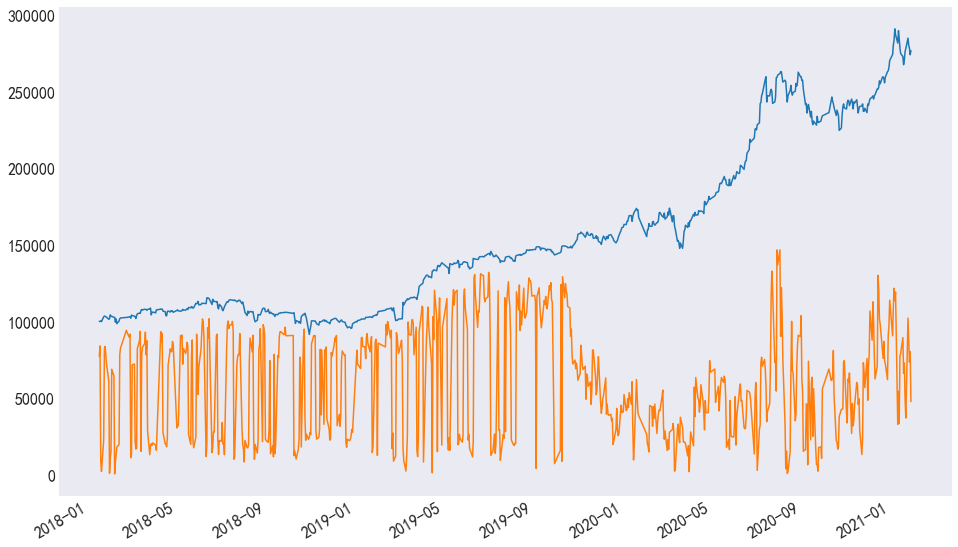

In [27]:
core.balance.sum(axis=1).plot()
core.balance.cash.plot()

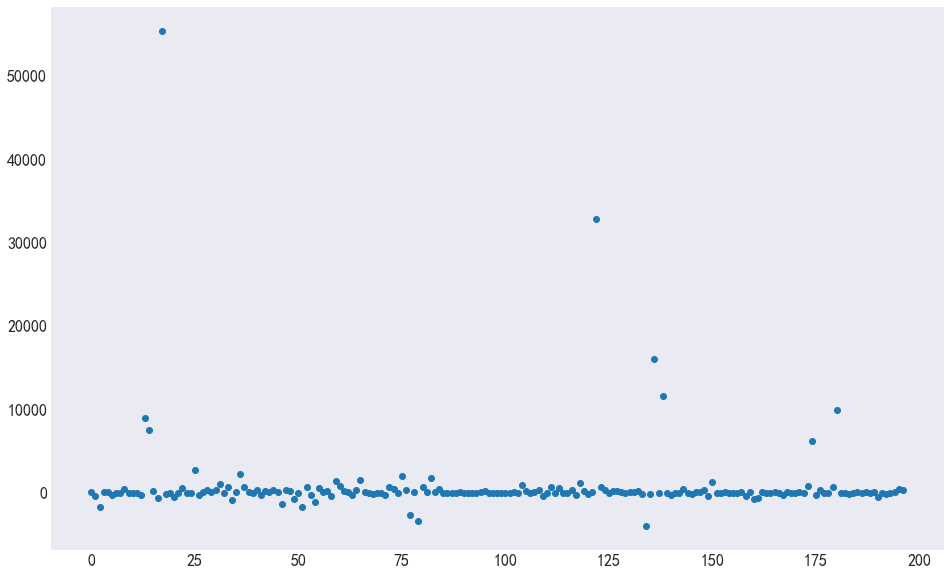

In [28]:
plt.scatter(np.arange(len(core.profit.sum().values)),core.profit.sum().values)

In [29]:
core.balance.sum(axis=1)

2018-01-16    100241.0
2018-01-17    100243.0
2018-01-18    100629.0
2018-01-19    100109.0
2018-01-22    103192.0
                ...   
2021-01-25    285270.0
2021-01-26    280607.0
2021-01-27    278608.0
2021-01-28    274428.0
2021-01-29    277148.0
Length: 740, dtype: float64

In [30]:
core.profit.sum().sort_values()

600745    -3940.000000
300223    -3444.000000
300142    -2665.932292
000063    -1770.000000
002304    -1737.000000
              ...     
601888     9936.070312
600809    11625.593750
600763    16062.812500
600519    32836.000000
000661    55303.000000
Length: 197, dtype: float64

In [31]:
import quantstats as qs
qs.extend_pandas()

In [32]:
value=core.balance.sum(axis=1)

In [33]:
drt=(value-value.shift(1))/value

In [34]:
value

2018-01-16    100241.0
2018-01-17    100243.0
2018-01-18    100629.0
2018-01-19    100109.0
2018-01-22    103192.0
                ...   
2021-01-25    285270.0
2021-01-26    280607.0
2021-01-27    278608.0
2021-01-28    274428.0
2021-01-29    277148.0
Length: 740, dtype: float64

In [35]:
qs.stats.sharpe(value)

1.5727702892175817

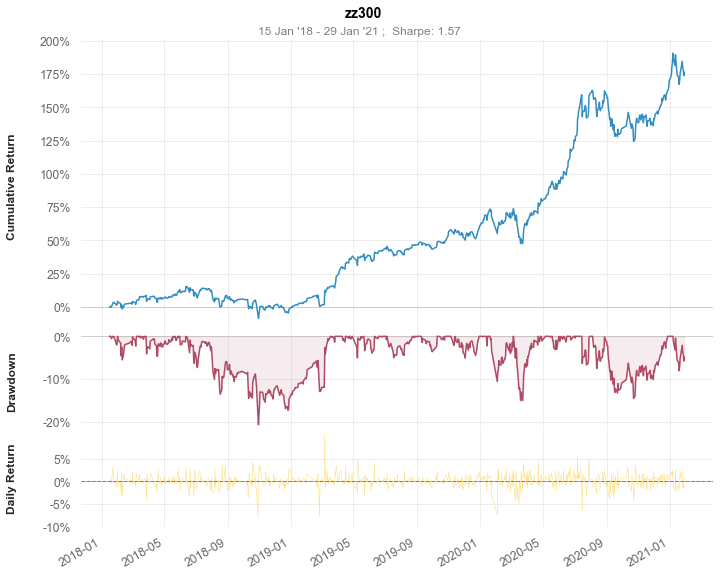

In [36]:
qs.plots.snapshot(value,title="zz300")

In [ ]:
dl.sdata.plot

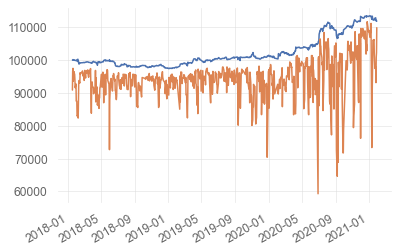

In [37]:
core.strategy[0].balance.sum(axis=1).plot()
core.strategy[0].balance.cash.plot()

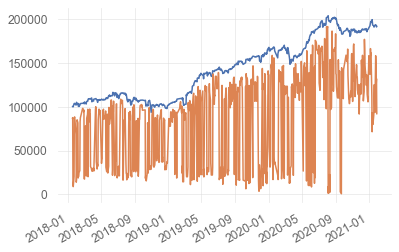

In [38]:
core.strategy[1].balance.sum(axis=1).plot()
core.strategy[1].balance.cash.plot()